In [164]:
#Imports
from sympy import *
import pandas as pd
import numpy as np
from text_unidecode import unidecode
from forex_python.converter import CurrencyRates
import locale
from re import sub
from decimal import Decimal
from wordcloud import WordCloud
from wordcloud import ImageColorGenerator
from wordcloud import STOPWORDS
import matplotlib.pyplot as plt
import seaborn as sns
import folium
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score

In [165]:
curr_rates = CurrencyRates()

In [166]:
    # Initial cleanup
    #1. Reading the data from the csv file and dropping unwanted columns
    airbnb_listings = pd.read_csv("listings.csv");
    columns_to_keep = [
        'id',
        'name',
        'host_id',
        'host_name',
        'neighbourhood_cleansed',
        'latitude',
        'longitude',
        'room_type',
        'price',
        'minimum_nights',
        'number_of_reviews',
        'last_review',
        'review_scores_rating',
        'review_scores_accuracy',
        'review_scores_cleanliness',
        'review_scores_checkin',
        'review_scores_communication',
        'review_scores_location',
        'review_scores_value',
        'reviews_per_month',
        'calculated_host_listings_count',
        'availability_365'
    ]
    airbnb_listings = airbnb_listings[columns_to_keep]
    
    #2. Removing rows where no of reviews is 0
    mask = airbnb_listings['number_of_reviews'] != 0
    airbnb_listings = airbnb_listings[mask]
    airbnb_listings.reset_index(drop=True, inplace=True)
    
    #3. Cleaning up the neighbourhood_cleansed feature + modifying price    
    airbnb_listings.loc[airbnb_listings['neighbourhood_cleansed'] == "Nrrebro", 'neighbourhood_cleansed'] = "Nørrebro"
    airbnb_listings.loc[airbnb_listings['neighbourhood_cleansed'] == "sterbro", 'neighbourhood_cleansed'] = "Østerbro"
    airbnb_listings.loc[airbnb_listings['neighbourhood_cleansed'] == "Amager st", 'neighbourhood_cleansed'] = "Amager Øst"
    airbnb_listings.loc[airbnb_listings['neighbourhood_cleansed'] == "Brnshj-Husum", 'neighbourhood_cleansed'] = "Brønshøj-Husum"
    airbnb_listings.loc[airbnb_listings['neighbourhood_cleansed'] == "Vanlse", 'neighbourhood_cleansed'] = "Vanløse"

    pd.set_option('display.max_rows', airbnb_listings.shape[0]+1)          
    locale.setlocale(locale.LC_NUMERIC, '')
    airbnb_listings['price'] = pd.to_numeric(airbnb_listings['price'].str.replace('$', '').apply(locale.atof), errors='coerce')
    airbnb_listings['price'] *= curr_rates.get_rate('USD', 'DKK')
    airbnb_listings['price'] = airbnb_listings['price'].astype(int)
    airbnb_listings['price']
  

0          1699
1          4921
2          6151
3          1372
4          3698
5          2422
6          1167
7          1892
8          5519
9          3596
10         3785
11         1012
12          880
13         4357
14         2661
15         2814
16         3893
17         2661
18         3406
19         2534
20         3630
21         1408
22          946
23         3493
24         1324
25         1832
26         1947
27         1427
28         3785
29          618
30         2451
31          882
32         4357
33         3041
34         2163
35         1669
36         1760
37         3940
38         1618
39         1429
40          473
41         2801
42         1888
43         4873
44          946
45         3569
46         2759
47         1126
48         2271
49         1235
50         1608
51         2831
52         7570
53         1608
54          717
55         1234
56         2070
57          764
58         1892
59         1500
60         1595
61         4379
62      

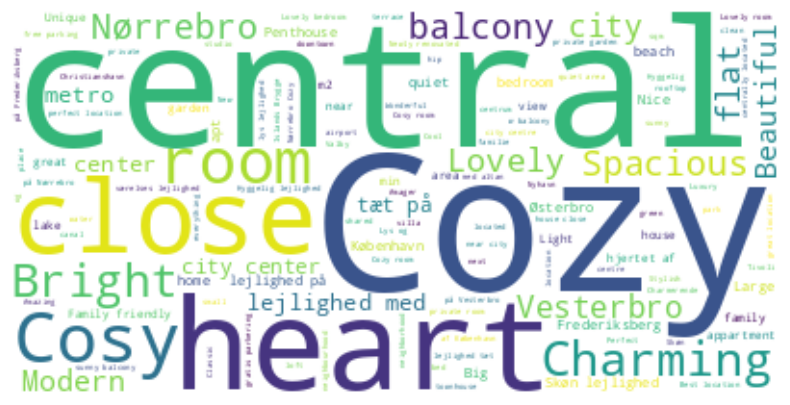

In [167]:
    # Word Clouds
    #4. word cloud on the 'name' column
    text = " ".join(i for i in airbnb_listings.name)
    stopwords = ["Copenhagen", "CPH", "apartment"] + list(STOPWORDS)
    wordcloud = WordCloud(stopwords=stopwords, background_color="white").generate(text)
    plt.figure( figsize=(10,5))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis("off")
    plt.show()

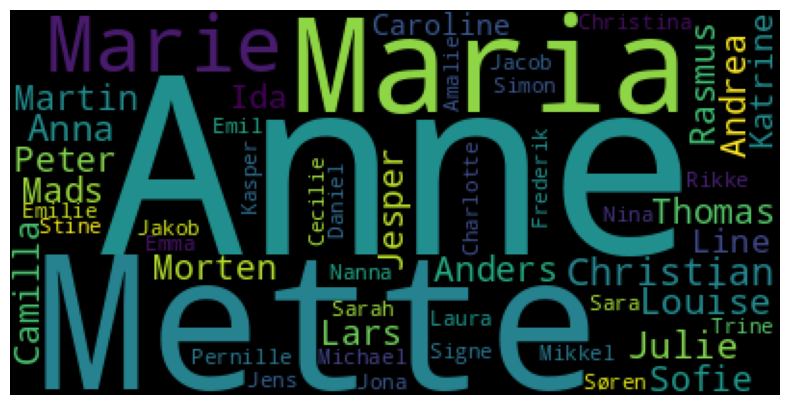

In [168]:
    #5. Host names word cloud
    text = " ".join(str(i) for i in airbnb_listings.host_name)
    stopwords = set(STOPWORDS)
    wordcloud = WordCloud(stopwords=stopwords, background_color="black").generate(text)
    plt.figure( figsize=(10,5))
    plt.imshow(wordcloud, interpolation='antialiased')
    plt.axis("off")
    plt.show()
    # it seems to mostly conform to the distribution on Danmarks Statistik, especially for female names

In [169]:
    #6.Binning price
    bins =  np.linspace(0, 9999, 10).tolist() + [10000, 122839]
    
    print(bins)
    airbnb_listings['price_bin'] = pd.cut(airbnb_listings['price'], bins=bins, labels=False)
    airbnb_listings['price_bin'] += 1
    airbnb_listings[['price','price_bin']].head(10)
    airbnb_listings[['price','price_bin']].head()

[0.0, 1111.0, 2222.0, 3333.0, 4444.0, 5555.0, 6666.0, 7777.0, 8888.0, 9999.0, 10000, 122839]


,price,price_bin
0,1699,2
1,4921,5
2,6151,6
3,1372,2
4,3698,4


In [101]:
    #7.Plotting it on a map
    # Creating a map centered around the average latitude and longitude
    m = folium.Map(location=[airbnb_listings['latitude'].mean(), airbnb_listings['longitude'].mean()], zoom_start=12)
    
    # Defining colors for price bins
    colors = ['blue', 'green', 'orange', 'red', 'purple', 'pink', 'brown', 'gray', 'black', 'yellow', 'cyan','teal']

    for i in range(len(airbnb_listings)):
        latitude = airbnb_listings.get('latitude')[i]
        longitude = airbnb_listings.get('longitude')[i]
        price_bin = airbnb_listings.get('price_bin')[i]
        price = airbnb_listings.get('price')[i]
        if latitude is not None and longitude is not None and price_bin is not None:
            folium.CircleMarker(
                location=[latitude, longitude],
                radius=5,
                color=colors[int(price_bin)],
                fill=True,
                fill_color=colors[int(price_bin)],
                fill_opacity=0.7,
                popup=price,
            ).add_to(m)
    m 

In [102]:
    #7. Grouping by neighbourhood  
    m = folium.Map(location=[airbnb_listings['latitude'].mean(), airbnb_listings['longitude'].mean()], zoom_start=12)    
    colors = ['blue', 'green', 'orange', 'red', 'purple', 'pink', 'brown', 'gray', 'black', 'cyan', 'teal','pink']
    all_neighbourhoods = airbnb_listings.get('neighbourhood_cleansed').unique()
    neighbourhood_color_mapping = dict(zip(all_neighbourhoods, colors))
    
    for i in range(len(airbnb_listings)):
        latitude = airbnb_listings.get('latitude')[i]
        longitude = airbnb_listings.get('longitude')[i]
        neighbourhood = airbnb_listings.get('neighbourhood_cleansed')[i]
        price_bin = airbnb_listings.get('price_bin')[i]
        popup_text = neighbourhood + "\nPrice: " + str(airbnb_listings.get('price')[i])
        if latitude is not None and longitude is not None and price_bin is not None:
            folium.CircleMarker(
                location=[latitude, longitude],
                radius=5,
                color=neighbourhood_color_mapping.get(neighbourhood),
                fill=True,
                fill_color=colors[int(price_bin)],
                fill_opacity=0.7,
                popup=popup_text,
            ).add_to(m)
    print(neighbourhood_color_mapping)
    m

{'Nørrebro': 'blue', 'Indre By': 'green', 'Vesterbro-Kongens Enghave': 'orange', 'Østerbro': 'red', 'Amager Vest': 'purple', 'Frederiksberg': 'pink', 'Amager Øst': 'brown', 'Valby': 'gray', 'Bispebjerg': 'black', 'Vanløse': 'cyan', 'Brønshøj-Husum': 'teal'}


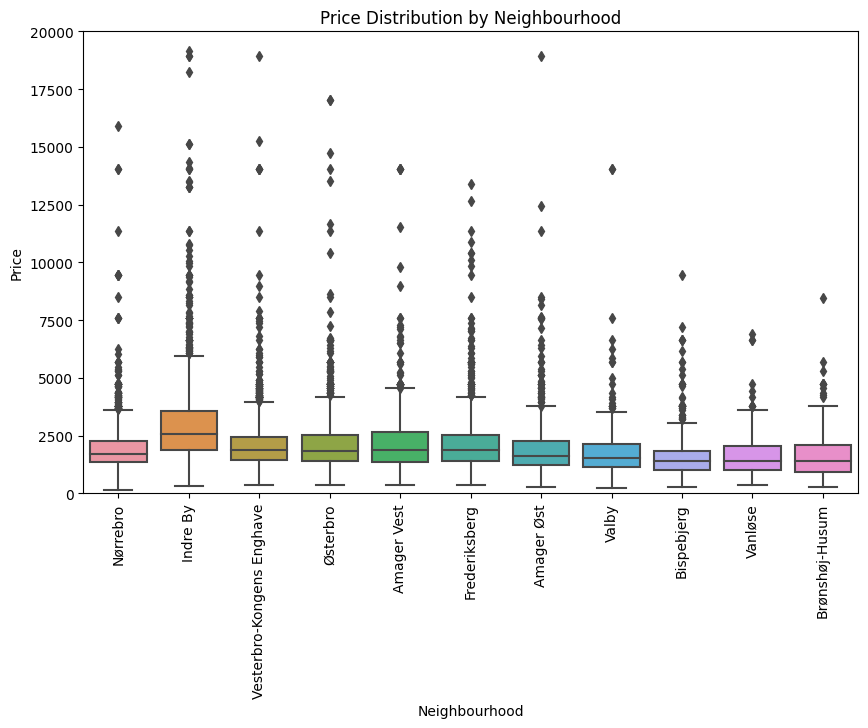

In [103]:
#8. Box plotting by neighbourhood and price
plt.figure(figsize=(10, 6))
sns.boxplot(data=airbnb_listings, x='neighbourhood_cleansed', y='price')
plt.title('Price Distribution by Neighbourhood')
plt.xlabel('Neighbourhood')
plt.ylabel('Price')
plt.xticks(rotation=90)
plt.ylim(0, 20000)
plt.show()

# This shows that half of the listings in each neighbourhood revolve around the same price as in other neighbourhoods

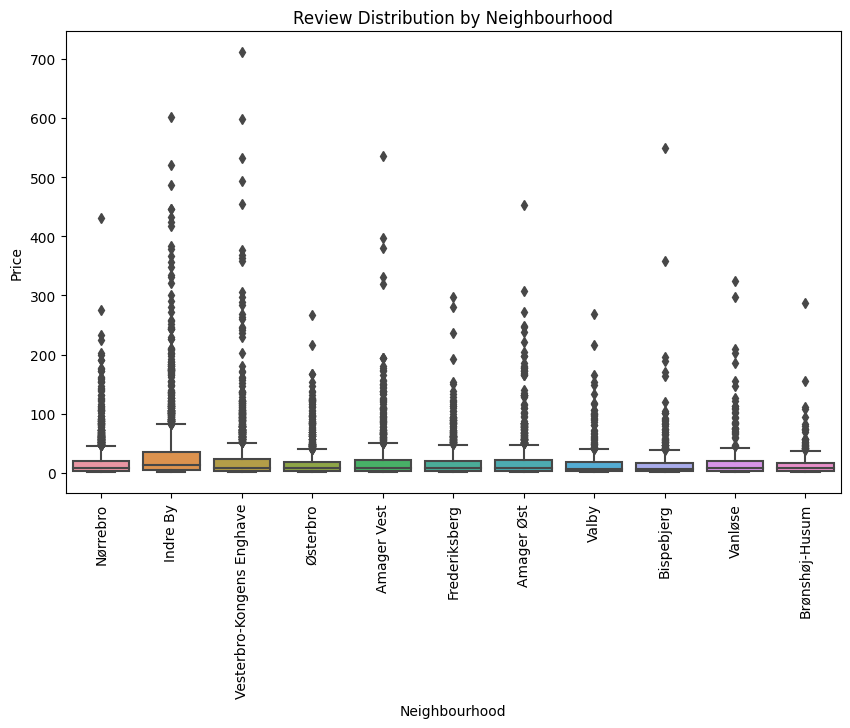

In [104]:
# Box plotting by neighbourhood and number of reviews
plt.figure(figsize=(10, 6))
sns.boxplot(data=airbnb_listings, x='neighbourhood_cleansed', y='number_of_reviews')
plt.title('Review Distribution by Neighbourhood')
plt.xlabel('Neighbourhood')
plt.ylabel('Price')
plt.xticks(rotation=90)
plt.show()


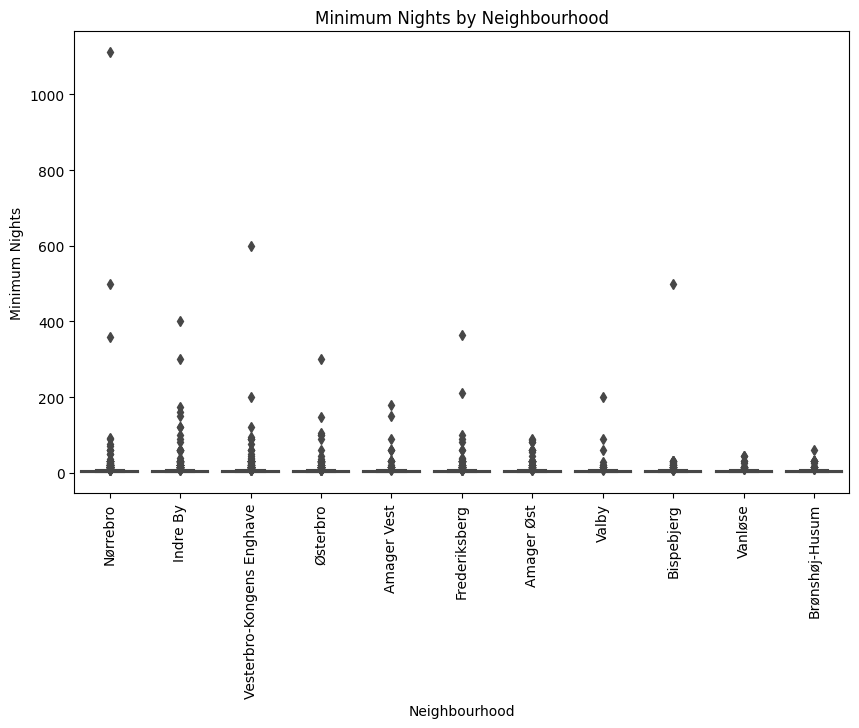

In [105]:
 #Box plotting by neighbourhood and minimum nights
plt.figure(figsize=(10, 6))
sns.boxplot(data=airbnb_listings, x='neighbourhood_cleansed', y='minimum_nights')
plt.title('Minimum Nights by Neighbourhood')
plt.xlabel('Neighbourhood')
plt.ylabel('Minimum Nights')
plt.xticks(rotation=90)
plt.show()

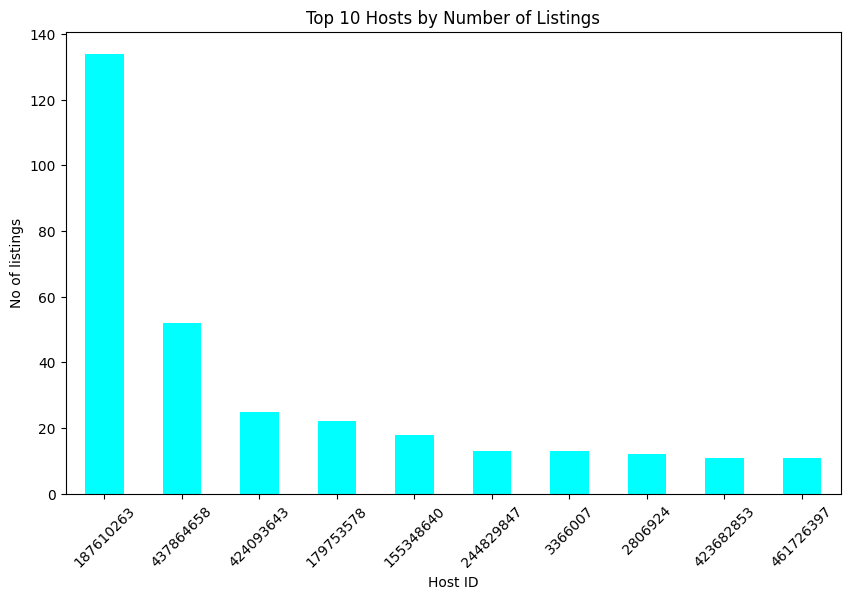

In [106]:
#9. Bar chart of hosts with top ten listings
hosts = airbnb_listings['host_id'].value_counts().head(10)
plt.figure(figsize=(10, 6))
hosts.plot(kind='bar', color='cyan')
plt.xlabel('Host ID')
plt.ylabel('No of listings')
plt.title('Top 10 Hosts by Number of Listings')
plt.xticks(rotation=45) 
plt.show()

In [107]:
#10. Statistics by neighbourhood
stats = airbnb_listings.groupby(['neighbourhood_cleansed', 'room_type', 'number_of_reviews', 'minimum_nights'])['price'].agg(
    mean='mean',
    mode=lambda x: x.mode().iat[0] if not x.empty else None,
    median='median',
    std='std',
    min='min',
    max='max',
    q25=lambda x: x.quantile(0.25),
    q75=lambda x: x.quantile(0.75)
).reset_index()

stats.head(50)

,neighbourhood_cleansed,room_type,number_of_reviews,minimum_nights,mean,mode,median,std,min,max,q25,q75
0,Amager Vest,Entire home/apt,1,1,2677.800000,1514,1826.0,2789.285979,755,14061,1514.00,2669.50
1,Amager Vest,Entire home/apt,1,2,2244.357143,2365,2179.0,556.267590,1041,3028,1915.75,2719.00
2,Amager Vest,Entire home/apt,1,3,1924.200000,946,1750.5,914.242948,605,3785,1267.00,2767.75
3,Amager Vest,Entire home/apt,1,4,2874.090909,4731,2649.0,1026.998486,1852,4731,2088.00,3070.50
4,Amager Vest,Entire home/apt,1,5,2918.090909,1892,1892.0,2066.381400,1135,7570,1621.50,3121.50
5,Amager Vest,Entire home/apt,1,6,1923.500000,1892,1892.0,382.079442,1323,2460,1821.50,2105.00
6,Amager Vest,Entire home/apt,1,7,1910.666667,1230,2231.0,589.813812,1230,2271,1730.50,2251.00
7,Amager Vest,Entire home/apt,1,14,2144.000000,1892,2144.0,356.381818,1892,2396,2018.00,2270.00
8,Amager Vest,Entire home/apt,1,16,832.000000,832,832.0,NaN,832,832,832.00,832.00
9,Amager Vest,Entire home/apt,1,30,1230.000000,1230,1230.0,NaN,1230,1230,1230.00,1230.00


In [108]:
    #11. Top ten highest rating listings + map
    m = folium.Map(location=[airbnb_listings['latitude'].mean(), airbnb_listings['longitude'].mean()], zoom_start=12)    
    top_ten = airbnb_listings.nlargest(10, 'review_scores_rating')
    
    for i in range(len(top_ten)):
        latitude = airbnb_listings.get('latitude')[i]
        longitude = airbnb_listings.get('longitude')[i]
        popup_text = "Review score:\n" + str(airbnb_listings.get('review_scores_rating')[i])
        if latitude is not None and longitude is not None and price_bin is not None:
            folium.Marker(
                location=[latitude, longitude],
                radius=5,
                color='blue',
                popup=popup_text,
            ).add_to(m)
    m

In [170]:
#12.Feature engineering
#Creating dummy varibales for room type and neighbourhoods and dropping
airbnb_listings = pd.get_dummies(airbnb_listings, columns=['room_type', 'neighbourhood_cleansed'])
airbnb_listings = airbnb_listings.dropna(axis = 0)


12126

In [171]:
#13. Add price category and encode as expensive or affordable
median_price = airbnb_listings['price'].median()
airbnb_listings['price_category'] = (airbnb_listings['price'] > median_price).astype(int)
airbnb_listings[['price', 'price_category']].head()
airbnb_listings.columns

Index(['id', 'name', 'host_id', 'host_name', 'latitude', 'longitude', 'price',
       'minimum_nights', 'number_of_reviews', 'last_review',
       'review_scores_rating', 'review_scores_accuracy',
       'review_scores_cleanliness', 'review_scores_checkin',
       'review_scores_communication', 'review_scores_location',
       'review_scores_value', 'reviews_per_month',
       'calculated_host_listings_count', 'availability_365', 'price_bin',
       'room_type_Entire home/apt', 'room_type_Hotel room',
       'room_type_Private room', 'room_type_Shared room',
       'neighbourhood_cleansed_Amager Vest',
       'neighbourhood_cleansed_Amager Øst',
       'neighbourhood_cleansed_Bispebjerg',
       'neighbourhood_cleansed_Brønshøj-Husum',
       'neighbourhood_cleansed_Frederiksberg',
       'neighbourhood_cleansed_Indre By', 'neighbourhood_cleansed_Nørrebro',
       'neighbourhood_cleansed_Valby', 'neighbourhood_cleansed_Vanløse',
       'neighbourhood_cleansed_Vesterbro-Kongens Enghave'

In [172]:
#14. Splitting the data and training the model

y = airbnb_listings['price_category']
X = airbnb_listings.drop(columns=['price_category', 'name', 'host_id','id','host_name','last_review','latitude','longitude','minimum_nights']);
X_train, X_test, y_train, y_test = train_test_split(
    X, y, stratify=y,test_size=0.33, random_state=69)

In [173]:
# Naive Bayes
from sklearn.naive_bayes import GaussianNB
model = GaussianNB()
model.fit(X_train, y_train)
model.score(X_test,y_test)


0.8440779610194903

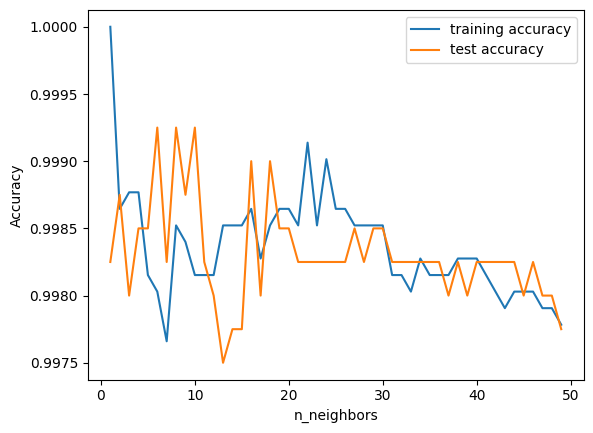

In [174]:
#KNN
from sklearn.neighbors import KNeighborsClassifier

training_accuracy = []
test_accuracy = []
# try n_neighbors from 1 to 20
neighbors_settings = range(1, 50)

for n_neighbors in neighbors_settings:
    # build the model
    clf = KNeighborsClassifier(n_neighbors=n_neighbors)
    clf.fit(X_train.values, y_train.values)
    # record training set accuracy
    training_accuracy.append(clf.score(X_train.values, y_train.values))
    # record generalization accuracy
    test_accuracy.append(clf.score(X_test.values, y_test.values))
    
plt.plot(neighbors_settings, training_accuracy, label="training accuracy")
plt.plot(neighbors_settings, test_accuracy, label="test accuracy")
plt.ylabel("Accuracy")
plt.xlabel("n_neighbors")
plt.legend();

In [175]:
from sklearn.tree import DecisionTreeClassifier
tree = DecisionTreeClassifier() 
tree.fit(X_train,y_train)
print("Accuracy on training data = {}".format(tree.score(X_train, y_train)))
print("Accuracy on testing data = {}\n".format(tree.score(X_test, y_test)))

Accuracy on training data = 1.0
Accuracy on testing data = 1.0



## 15. Conclusion to the assignment